In [1]:
import nltk
from nltk.stem import WordNetLemmatizer
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import re

In [2]:
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Jegadit\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Jegadit\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [3]:
df = pd.read_csv("../dataset/reviews.csv")
df

,Unnamed: 0,position,midb_id,movie,spoilers,rating,title,user,date,content
0,0,0,tt0111161,The Shawshank Redemption,False,1/10,Pale imitation of better films,sbaradell,10 July 2003,"Three words: ""Cool Hand Luke."" Same film, don..."
1,1,0,tt0111161,The Shawshank Redemption,False,1/10,Didactic and overlong,arthur_pewtey,19 November 2000,Another one of those overlong morally right-on...
2,2,0,tt0111161,The Shawshank Redemption,False,1/10,Mediocre people reward mediocre cinema.,kylemax,24 May 2005,It bugs me that this movie is rated so high- n...
3,3,0,tt0111161,The Shawshank Redemption,False,1/10,The plain & simple truth. It doesn\'t deserve ...,lukemccaine,10 June 2007,just read the title. Tough I think it's a pret...
4,4,0,tt0111161,The Shawshank Redemption,False,1/10,Not the greatest movie of all time,Hollywd-2,10 May 1999,Shawshank is nothing more than a fairy tale. ...
...,...,...,...,...,...,...,...,...,...,...
20306,20306,49,tt0022100,M - Eine Stadt sucht einen M\xc3\xb6rder,False,10/10,extremely scary,chewy_548,24 August 2005,peter Lorre is the best child serial killer ci...
20307,20307,49,tt0022100,M - Eine Stadt sucht einen M\xc3\xb6rder,False,10/10,Classic Mystery,dee_in_dakota,26 April 2005,I thoroughly enjoyed watching this film. Seein...
20308,20308,49,tt0022100,M - Eine Stadt sucht einen M\xc3\xb6rder,False,10/10,"One of the most influential films ever, almost...",Unimonster,27 September 2003,"One of the most influential films ever, almost..."
20309,20309,49,tt0022100,M - Eine Stadt sucht einen M\xc3\xb6rder,False,10/10,M a few thoughts,rxcdr,28 March 2003,"I will not take time to praise the film, as ot..."


In [4]:
len(df["movie"].unique())

105

In [5]:
data = df[["movie", "rating", "title" ,"content"]]
data.head()

,movie,rating,title,content
0,The Shawshank Redemption,1/10,Pale imitation of better films,"Three words: ""Cool Hand Luke."" Same film, don..."
1,The Shawshank Redemption,1/10,Didactic and overlong,Another one of those overlong morally right-on...
2,The Shawshank Redemption,1/10,Mediocre people reward mediocre cinema.,It bugs me that this movie is rated so high- n...
3,The Shawshank Redemption,1/10,The plain & simple truth. It doesn\'t deserve ...,just read the title. Tough I think it's a pret...
4,The Shawshank Redemption,1/10,Not the greatest movie of all time,Shawshank is nothing more than a fairy tale. ...


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20311 entries, 0 to 20310
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   movie    20311 non-null  object
 1   rating   20311 non-null  object
 2   title    20311 non-null  object
 3   content  20311 non-null  object
dtypes: object(4)
memory usage: 634.8+ KB


In [7]:
data.nunique()

movie        105
rating        10
title      18858
content    20261
dtype: int64

In [8]:
with open('../JSS file/stopwords.txt') as f:
    stopwords = f.readlines()
    f.close()

stopwords = [w.split('\n')[0] for w in stopwords if w.endswith('\n')]
len(stopwords)

732

In [9]:
data.loc[0]['content']

'Three words: "Cool Hand Luke."  Same film, done better, done earlier.  For that matter, is this film any better than other Steven King "novelettes" such as "Stand By Me"? All in all, it probably ranks a 6 or a 7, but since people on this site have lost their minds as regards this film, I give it a 1 in one man\'s attempt at sanity.'

In [10]:
data["title"][data["title"].duplicated()].shape

(1453,)

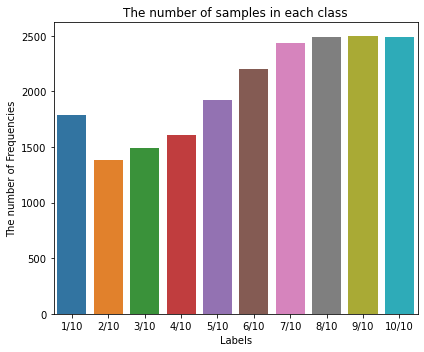

In [11]:
plt.figure(figsize=(6, 5))
sns.countplot(data=data, x='rating');
plt.title('The number of samples in each class');
plt.xlabel('Labels');
plt.ylabel('The number of Frequencies');
plt.tight_layout();

# Pre-Processing

### Cleaning, tokenize, remove stopwords, lematizing

In [13]:
lemmatizer = WordNetLemmatizer()
for index, row in data.iterrows():
    filter_sentence = []
    sentence = row['content']
    sentence = re.sub(r'[^\w\s]','',sentence)
    words = nltk.word_tokenize(sentence)
    words = [w for w in words if not w in stopwords]
    for word in words:
        filter_sentence.append(lemmatizer.lemmatize(word))
    print(index, filter_sentence)
    data['content'][index] = filter_sentence


0 ['Three', 'word', 'Cool', 'Hand', 'Luke', 'Same', 'film', 'earlier', 'For', 'matter', 'film', 'Steven', 'King', 'novelette', 'Stand', 'By', 'Me', 'All', 'rank', '6', '7', 'people', 'site', 'lost', 'mind', 'regard', 'film', 'I', 'give', '1', 'man', 'attempt', 'sanity']
1 ['Another', 'overlong', 'morally', 'righton', 'movie', 'rise', 'average', 'only', 'actingIts', 'bleedingheart', 'politics', 'dignity', 'individual', 'maintained', 'adverse', 'condition', 'playedout', 'well', 'enough', 'actually', 'lack', 'real', 'dramatic', 'tensionDufrane', 'twodimensional', 'character', 'who', 'drama', 'number', 'there', 'doubt', 'will', 'triumph', 'end', 'only', 'matter', 'howTim', 'Robbins', 'interesting', 'film', 'try', 'The', 'Player', 'Bob', 'Roberts', 'youre', 'looking', 'dramamoral', 'ambivalence', 'interactBasically', 'prison', 'film', 'Jailhouse', 'Rock', 'startersLike', 'Stephen', 'King', 'story', 'prosaic', 'There', 'story', 'here', 'overinflated', 'lost', 'waynOne', 'watch', 'rainy', 'da

<ipython-input-13-0c4d6d07befb>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['content'][index] = filter_sentence


53 ['This', 'movie', 'total', 'piece', 'manipulation', 'It', 'redeeming', 'feature', 'Morgan', 'Freemans', 'narration', 'pure', 'art', 'This', 'guy', 'act', 'mouth', 'As', 'piece', 'fiction', 'merit', 'I', 'can', 'see', 'people', 'enjoy', 'But', 'classed', 'best', 'movie', 'time', 'Cmon', 'Certainly', 'portrayal', 'brutality', 'guard', 'time', 'I', 'say', 'fairly', 'realisticThe', 'part', 'story', 'old', 'timer', 'released', 'ring', 'true', 'There', 'people', 'like', 'who', 'totally', 'institutionalized', 'skill', 'survive', 'support', 'network', 'placeThis', 'movie', 'people', 'who', 'like', 'laid', 'perfectly', 'doesnt', 'require', 'thinking', 'Personally', 'I', 'like', 'bit', 'depth', 'realityI', 'dont', 'want', 'put', 'people', 'seeing', 'watched', 'once', 'But', 'flaw', 'outweigh', 'redeeming', 'feature']
54 ['I', 'friend', 'I', 'can', 'discus', 'movie', 'day', 'Generally', 'similar', 'taste', 'critique', 'Shawshank', 'only', 'movie', 'completely', 'disagree', 'This', 'movie', 'in

In [14]:
data

,movie,rating,title,content
0,The Shawshank Redemption,1/10,Pale imitation of better films,"[Three, word, Cool, Hand, Luke, Same, film, ea..."
1,The Shawshank Redemption,1/10,Didactic and overlong,"[Another, overlong, morally, righton, movie, r..."
2,The Shawshank Redemption,1/10,Mediocre people reward mediocre cinema.,"[It, bug, movie, rated, high, bad, movie, medi..."
3,The Shawshank Redemption,1/10,The plain & simple truth. It doesn\'t deserve ...,"[just, read, title, Tough, I, think, pretty, d..."
4,The Shawshank Redemption,1/10,Not the greatest movie of all time,"[Shawshank, fairy, tale, It, tell, prison, lik..."
...,...,...,...,...
20306,M - Eine Stadt sucht einen M\xc3\xb6rder,10/10,extremely scary,"[peter, Lorre, best, child, serial, killer, ci..."
20307,M - Eine Stadt sucht einen M\xc3\xb6rder,10/10,Classic Mystery,"[I, enjoyed, watching, film, Seeing, Peter, Lo..."
20308,M - Eine Stadt sucht einen M\xc3\xb6rder,10/10,"One of the most influential films ever, almost...","[One, influential, film, filmed, story, Psycho..."
20309,M - Eine Stadt sucht einen M\xc3\xb6rder,10/10,M a few thoughts,"[I, will, take, time, praise, film, far, I, ca..."


# N-gram model

In [15]:
from nltk.util import ngrams

def generate_bigrams(text):
    words = nltk.word_tokenize(text)
    bigram_list = list(ngrams(words, 2))
    bigram_string = ([' '.join(bigram) for bigram in bigram_list])
    return bigram_string

def generate_trigrams(text):
    words = nltk.word_tokenize(text)
    trigram_list = list(ngrams(words, 3))
    trigram_string = ([' '.join(trigram) for trigram in trigram_list])
    return trigram_string


def generate_fourgrams(text):
    words = nltk.word_tokenize(text)
    fourgram_list = list(ngrams(words, 4))
    fourgram_string = ([' '.join(fourgram) for fourgram in fourgram_list])
    return fourgram_string


df['bigram'] = df['content'].apply(generate_bigrams)
df['trigram'] = df['content'].apply(generate_trigrams)
df['fourgram'] = df['content'].apply(generate_fourgrams)
df.head()

,Unnamed: 0,position,midb_id,movie,spoilers,rating,title,user,date,content,bigram,trigram,fourgram
0,0,0,tt0111161,The Shawshank Redemption,False,1/10,Pale imitation of better films,sbaradell,10 July 2003,"Three words: ""Cool Hand Luke."" Same film, don...","[Three words, words :, : ``, `` Cool, Cool Han...","[Three words :, words : ``, : `` Cool, `` Cool...","[Three words : ``, words : `` Cool, : `` Cool ..."
1,1,0,tt0111161,The Shawshank Redemption,False,1/10,Didactic and overlong,arthur_pewtey,19 November 2000,Another one of those overlong morally right-on...,"[Another one, one of, of those, those overlong...","[Another one of, one of those, of those overlo...","[Another one of those, one of those overlong, ..."
2,2,0,tt0111161,The Shawshank Redemption,False,1/10,Mediocre people reward mediocre cinema.,kylemax,24 May 2005,It bugs me that this movie is rated so high- n...,"[It bugs, bugs me, me that, that this, this mo...","[It bugs me, bugs me that, me that this, that ...","[It bugs me that, bugs me that this, me that t..."
3,3,0,tt0111161,The Shawshank Redemption,False,1/10,The plain & simple truth. It doesn\'t deserve ...,lukemccaine,10 June 2007,just read the title. Tough I think it's a pret...,"[just read, read the, the title, title ., . To...","[just read the, read the title, the title ., t...","[just read the title, read the title ., the ti..."
4,4,0,tt0111161,The Shawshank Redemption,False,1/10,Not the greatest movie of all time,Hollywd-2,10 May 1999,Shawshank is nothing more than a fairy tale. ...,"[Shawshank is, is nothing, nothing more, more ...","[Shawshank is nothing, is nothing more, nothin...","[Shawshank is nothing more, is nothing more th..."


In [16]:
! pip install expects tabulate

DEPRECATION: pyodbc 4.0.0-unsupported has a non-standard version number. pip 23.3 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of pyodbc or contact the author to suggest that they release a version with a conforming version number. Discussion can be found at https://github.com/pypa/pip/issues/12063

[notice] A new release of pip is available: 23.2.1 -> 23.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [17]:
from functools import partial
from pprint import pprint
import math
from expects import be_true, expect, have_keys
from tabulate import tabulate
import numpy as np

In [18]:
data.iloc[10000]

movie                                             Casablanca
rating                                                  4/10
title                                             Casaboring
content    [This, noting, boring, story, take, place, wor...
Name: 10000, dtype: object

In [19]:
from nltk.corpus import reuters
from nltk import bigrams, trigrams
from collections import Counter, defaultdict
# Create a placeholder for model
model = defaultdict(lambda: defaultdict(lambda: 0))
# Count frequency of co-occurrence  
for w1, w2, w3 in trigrams(data['content'].iloc[10000], pad_right=True, pad_left=True):
    model[(w1, w2)][w3] += 1
 # Let's transform the counts to probabilities
for w1_w2 in model:
    total_count = float(sum(model[w1_w2].values()))
    for w3 in model[w1_w2]:
        model[w1_w2][w3] /= total_count

In [20]:
model

defaultdict(<function __main__.<lambda>()>,
            {(None,
              None): defaultdict(<function __main__.<lambda>.<locals>.<lambda>()>, {'This': 1.0}),
             (None,
              'This'): defaultdict(<function __main__.<lambda>.<locals>.<lambda>()>, {'noting': 1.0}),
             ('This',
              'noting'): defaultdict(<function __main__.<lambda>.<locals>.<lambda>()>, {'boring': 1.0}),
             ('noting',
              'boring'): defaultdict(<function __main__.<lambda>.<locals>.<lambda>()>, {'story': 1.0}),
             ('boring',
              'story'): defaultdict(<function __main__.<lambda>.<locals>.<lambda>()>, {'take': 1.0}),
             ('story',
              'take'): defaultdict(<function __main__.<lambda>.<locals>.<lambda>()>, {'place': 1.0}),
             ('take',
              'place'): defaultdict(<function __main__.<lambda>.<locals>.<lambda>()>, {'world': 1.0}),
             ('place',
              'world'): defaultdict(<function __main__.<lamb

In [21]:
#predict the model
print(dict(model["boring", "story"]))

{'take': 1.0}


# Perplexity

In [22]:
from nltk import ngrams

def nGram(comment, n):
    comment = comment.split()
    n_grams = ngrams(comment, n)
    return [' '.join(grams) for grams in n_grams]

# bigrams
df['bigrams'] = df['content'].apply(nGram, n=2)
df.head(10)

,Unnamed: 0,position,midb_id,movie,spoilers,rating,title,user,date,content,bigram,trigram,fourgram,bigrams
0,0,0,tt0111161,The Shawshank Redemption,False,1/10,Pale imitation of better films,sbaradell,10 July 2003,"Three words: ""Cool Hand Luke."" Same film, don...","[Three words, words :, : ``, `` Cool, Cool Han...","[Three words :, words : ``, : `` Cool, `` Cool...","[Three words : ``, words : `` Cool, : `` Cool ...","[Three words:, words: ""Cool, ""Cool Hand, Hand ..."
1,1,0,tt0111161,The Shawshank Redemption,False,1/10,Didactic and overlong,arthur_pewtey,19 November 2000,Another one of those overlong morally right-on...,"[Another one, one of, of those, those overlong...","[Another one of, one of those, of those overlo...","[Another one of those, one of those overlong, ...","[Another one, one of, of those, those overlong..."
2,2,0,tt0111161,The Shawshank Redemption,False,1/10,Mediocre people reward mediocre cinema.,kylemax,24 May 2005,It bugs me that this movie is rated so high- n...,"[It bugs, bugs me, me that, that this, this mo...","[It bugs me, bugs me that, me that this, that ...","[It bugs me that, bugs me that this, me that t...","[It bugs, bugs me, me that, that this, this mo..."
3,3,0,tt0111161,The Shawshank Redemption,False,1/10,The plain & simple truth. It doesn\'t deserve ...,lukemccaine,10 June 2007,just read the title. Tough I think it's a pret...,"[just read, read the, the title, title ., . To...","[just read the, read the title, the title ., t...","[just read the title, read the title ., the ti...","[just read, read the, the title., title. Tough..."
4,4,0,tt0111161,The Shawshank Redemption,False,1/10,Not the greatest movie of all time,Hollywd-2,10 May 1999,Shawshank is nothing more than a fairy tale. ...,"[Shawshank is, is nothing, nothing more, more ...","[Shawshank is nothing, is nothing more, nothin...","[Shawshank is nothing more, is nothing more th...","[Shawshank is, is nothing, nothing more, more ..."
5,5,0,tt0111161,The Shawshank Redemption,False,1/10,Am i missing something??,sicurrie,18 July 2005,The basic story for this dreadful movie is And...,"[The basic, basic story, story for, for this, ...","[The basic story, basic story for, story for t...","[The basic story for, basic story for this, st...","[The basic, basic story, story for, for this, ..."
6,6,0,tt0111161,The Shawshank Redemption,False,1/10,Sugary sentimental and unsatisfying,Irish_Pete,2 October 2006,This drama has been widely vaunted as one of t...,"[This drama, drama has, has been, been widely,...","[This drama has, drama has been, has been wide...","[This drama has been, drama has been widely, h...","[This drama, drama has, has been, been widely,..."
7,7,0,tt0111161,The Shawshank Redemption,False,1/10,Cliche,mdicki02,25 February 2000,This film is nothing but one cliche after anot...,"[This film, film is, is nothing, nothing but, ...","[This film is, film is nothing, is nothing but...","[This film is nothing, film is nothing but, is...","[This film, film is, is nothing, nothing but, ..."
8,8,0,tt0111161,The Shawshank Redemption,False,1/10,what is all the fuss about,kluismans,22 November 2006,"i had to comment, i really did, all those eulo...","[i had, had to, to comment, comment ,, , i, i ...","[i had to, had to comment, to comment ,, comme...","[i had to comment, had to comment ,, to commen...","[i had, had to, to comment,, comment, i, i rea..."
9,9,0,tt0111161,The Shawshank Redemption,False,1/10,Most Overrated Film of All Time,RichBuck,11 February 2004,Sorry folks but this movie is a C movie and no...,"[Sorry folks, folks but, but this, this movie,...","[Sorry folks but, folks but this, but this mov...","[Sorry folks but this, folks but this movie, b...","[Sorry folks, folks but, but this, this movie,..."


In [23]:
import math
from collections import Counter

def compute_perplexity(bigrams):
    if len(bigrams) == 0:
        return 0 
    
    bigram_counts = Counter(bigrams)
    total_bigrams = len(bigrams)
    
    perplexity = math.exp(-sum(math.log(bigram_counts[bigram] / total_bigrams) for bigram in bigrams) / total_bigrams)
    
    return perplexity

df['perplexity'] = df['bigrams'].apply(compute_perplexity)

average_perplexity = sum(df['perplexity'])/len(df['perplexity'])
print("Average Perplexity is = ",average_perplexity)

for index, row in df.head(10).iterrows():
    print(f"Row Number {index + 1} Perplexity: {row['perplexity']}")
    print('---')

Average Perplexity is =  218.91700871602825
Row Number 1 Perplexity: 64.00000000000031
---
Row Number 2 Perplexity: 141.5581081709407
---
Row Number 3 Perplexity: 177.53799400661686
---
Row Number 4 Perplexity: 115.26175842641487
---
Row Number 5 Perplexity: 36.05001850443314
---
Row Number 6 Perplexity: 150.89641577248665
---
Row Number 7 Perplexity: 154.04521378161897
---
Row Number 8 Perplexity: 87.61690241161001
---
Row Number 9 Perplexity: 203.80784758162883
---
Row Number 10 Perplexity: 129.7444714123136
---


# POS tagging

In [24]:
import nltk

In [25]:
nltk.download('averaged_perceptron_tagger')
nltk.download('tagsets')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Jegadit\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package tagsets to
[nltk_data]     C:\Users\Jegadit\AppData\Roaming\nltk_data...
[nltk_data]   Package tagsets is already up-to-date!


True

In [27]:
df['POS'] = df['bigram'].apply(nltk.pos_tag)
df.head()

,Unnamed: 0,position,midb_id,movie,spoilers,rating,title,user,date,content,bigram,trigram,fourgram,bigrams,perplexity,POS
0,0,0,tt0111161,The Shawshank Redemption,False,1/10,Pale imitation of better films,sbaradell,10 July 2003,"Three words: ""Cool Hand Luke."" Same film, don...","[Three words, words :, : ``, `` Cool, Cool Han...","[Three words :, words : ``, : `` Cool, `` Cool...","[Three words : ``, words : `` Cool, : `` Cool ...","[Three words:, words: ""Cool, ""Cool Hand, Hand ...",64.000000,"[(Three words, NNS), (words :, VBP), (: ``, JJ..."
1,1,0,tt0111161,The Shawshank Redemption,False,1/10,Didactic and overlong,arthur_pewtey,19 November 2000,Another one of those overlong morally right-on...,"[Another one, one of, of those, those overlong...","[Another one of, one of those, of those overlo...","[Another one of those, one of those overlong, ...","[Another one, one of, of those, those overlong...",141.558108,"[(Another one, NNP), (one of, MD), (of those, ..."
2,2,0,tt0111161,The Shawshank Redemption,False,1/10,Mediocre people reward mediocre cinema.,kylemax,24 May 2005,It bugs me that this movie is rated so high- n...,"[It bugs, bugs me, me that, that this, this mo...","[It bugs me, bugs me that, me that this, that ...","[It bugs me that, bugs me that this, me that t...","[It bugs, bugs me, me that, that this, this mo...",177.537994,"[(It bugs, NNP), (bugs me, NN), (me that, WP),..."
3,3,0,tt0111161,The Shawshank Redemption,False,1/10,The plain & simple truth. It doesn\'t deserve ...,lukemccaine,10 June 2007,just read the title. Tough I think it's a pret...,"[just read, read the, the title, title ., . To...","[just read the, read the title, the title ., t...","[just read the title, read the title ., the ti...","[just read, read the, the title., title. Tough...",115.261758,"[(just read, NN), (read the, NN), (the title, ..."
4,4,0,tt0111161,The Shawshank Redemption,False,1/10,Not the greatest movie of all time,Hollywd-2,10 May 1999,Shawshank is nothing more than a fairy tale. ...,"[Shawshank is, is nothing, nothing more, more ...","[Shawshank is nothing, is nothing more, nothin...","[Shawshank is nothing more, is nothing more th...","[Shawshank is, is nothing, nothing more, more ...",36.050019,"[(Shawshank is, NNP), (is nothing, VBG), (noth..."


# NER

In [28]:
nltk.download('maxent_ne_chunker')
nltk.download('words')

[nltk_data] Downloading package maxent_ne_chunker to
[nltk_data]     C:\Users\Jegadit\AppData\Roaming\nltk_data...
[nltk_data]   Package maxent_ne_chunker is already up-to-date!
[nltk_data] Downloading package words to
[nltk_data]     C:\Users\Jegadit\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!


True

In [30]:
df['NER_chunk'] = df['bigram'].apply(nltk.ne_chunk)
df.head()

,Unnamed: 0,position,midb_id,movie,spoilers,rating,title,user,date,content,bigram,trigram,fourgram,bigrams,perplexity,POS,NER_chunk
0,0,0,tt0111161,The Shawshank Redemption,False,1/10,Pale imitation of better films,sbaradell,10 July 2003,"Three words: ""Cool Hand Luke."" Same film, don...","[Three words, words :, : ``, `` Cool, Cool Han...","[Three words :, words : ``, : `` Cool, `` Cool...","[Three words : ``, words : `` Cool, : `` Cool ...","[Three words:, words: ""Cool, ""Cool Hand, Hand ...",64.000000,"[(Three words, NNS), (words :, VBP), (: ``, JJ...","[Three words, words :, : ``, `` Cool, Cool Han..."
1,1,0,tt0111161,The Shawshank Redemption,False,1/10,Didactic and overlong,arthur_pewtey,19 November 2000,Another one of those overlong morally right-on...,"[Another one, one of, of those, those overlong...","[Another one of, one of those, of those overlo...","[Another one of those, one of those overlong, ...","[Another one, one of, of those, those overlong...",141.558108,"[(Another one, NNP), (one of, MD), (of those, ...","[Another one, one of, of those, those overlong..."
2,2,0,tt0111161,The Shawshank Redemption,False,1/10,Mediocre people reward mediocre cinema.,kylemax,24 May 2005,It bugs me that this movie is rated so high- n...,"[It bugs, bugs me, me that, that this, this mo...","[It bugs me, bugs me that, me that this, that ...","[It bugs me that, bugs me that this, me that t...","[It bugs, bugs me, me that, that this, this mo...",177.537994,"[(It bugs, NNP), (bugs me, NN), (me that, WP),...","[It bugs, bugs me, me that, that this, this mo..."
3,3,0,tt0111161,The Shawshank Redemption,False,1/10,The plain & simple truth. It doesn\'t deserve ...,lukemccaine,10 June 2007,just read the title. Tough I think it's a pret...,"[just read, read the, the title, title ., . To...","[just read the, read the title, the title ., t...","[just read the title, read the title ., the ti...","[just read, read the, the title., title. Tough...",115.261758,"[(just read, NN), (read the, NN), (the title, ...","[just read, read the, the title, title ., . To..."
4,4,0,tt0111161,The Shawshank Redemption,False,1/10,Not the greatest movie of all time,Hollywd-2,10 May 1999,Shawshank is nothing more than a fairy tale. ...,"[Shawshank is, is nothing, nothing more, more ...","[Shawshank is nothing, is nothing more, nothin...","[Shawshank is nothing more, is nothing more th...","[Shawshank is, is nothing, nothing more, more ...",36.050019,"[(Shawshank is, NNP), (is nothing, VBG), (noth...","[Shawshank is, is nothing, nothing more, more ..."


# Huggingface transformers

In [2]:
from transformers import pipeline